# Environment

In [1]:
# version: Python 3.8.5
# requirements.txt

# Imports and settings

In [2]:
import pandas as pd
import numpy as np
import pickle as pkl
import asyncio
import time

# create plots
import matplotlib.pyplot as plt
from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)

# load dataframes
mt = pkl.load(open('./pkl/movie_titles.pkl', 'rb'))
ts = pkl.load(open('./pkl/trainingSet_.pkl', 'rb')) # 20.01 s, 9G
ts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100480507 entries, 0 to 100480506
Data columns (total 4 columns):
 #   Column      Dtype 
---  ------      ----- 
 0   CustomerID  int32 
 1   Rating      int32 
 2   Date        object
 3   MovieID     int32 
dtypes: int32(3), object(1)
memory usage: 1.9+ GB


# Movie released per year

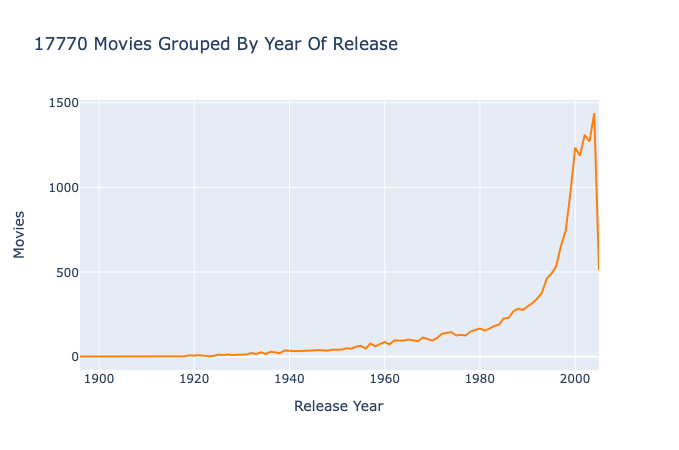

In [3]:
# get data
data = mt['YearOfRelease'].value_counts().sort_index()

# create trace
trace = go.Scatter(x = data.index,
                   y = data.values,
                   marker = dict(color = '#ff7f0e'))
# create layout
layout = dict(title = '{} Movies Grouped By Year Of Release'.format(mt.shape[0]),
              xaxis = dict(title = 'Release Year'),
              yaxis = dict(title = 'Movies'))

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

# Movie rating distribution

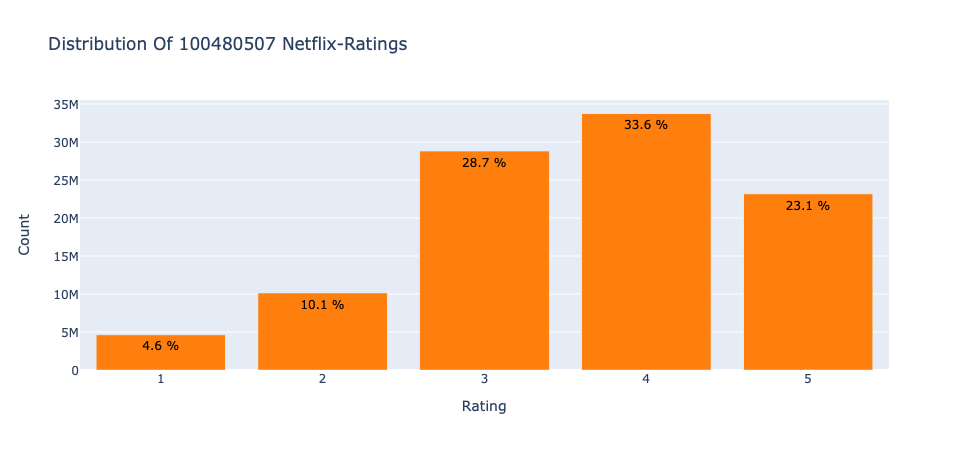

Average of rating: 3.60
Skewed to the left, skp: -1.09


In [5]:
# get data
data = ts['Rating'].value_counts().sort_index(ascending=False)

# create trace
trace = go.Bar(x = data.index,
               text = ['{:.1f} %'.format(val) for val in (data.values / ts.shape[0] * 100)],
               textposition = 'auto',
               textfont = dict(color = '#000000'),
               y = data.values,
               marker = dict(color = '#ff7f0e'))
# create layout
layout = dict(title = f'Distribution Of {ts.shape[0]} Netflix-Ratings',
              xaxis = dict(title = 'Rating'),
              yaxis = dict(title = 'Count'))
# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

# average ratings
avgRating = ts['Rating'].mean()
print(f'Average of rating: {avgRating:.2f}')

# sample Pearson coefficient skp
skp = (3*(ts['Rating'].mean() - 4))/ts['Rating'].std()
print(f'Skewed to the left, skp: {skp:.2f}')

# Movie rating date

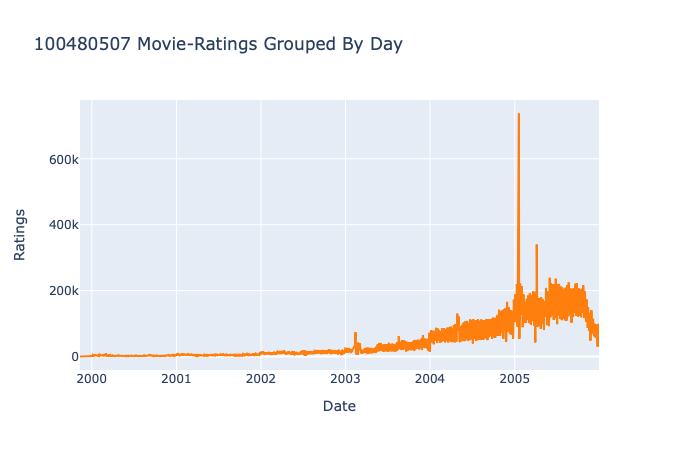

In [6]:
# get data
data = ts['Date'].value_counts()
data.index = pd.to_datetime(data.index)
data.sort_index(inplace=True)

# create trace
trace = go.Scatter(x = data.index,
                   y = data.values,
                   marker = dict(color = '#ff7f0e'))
# create layout
layout = dict(title = '{} Movie-Ratings Grouped By Day'.format(ts.shape[0]),
              xaxis = dict(title = 'Date'),
              yaxis = dict(title = 'Ratings'))

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

# Movie rating frequency distribution

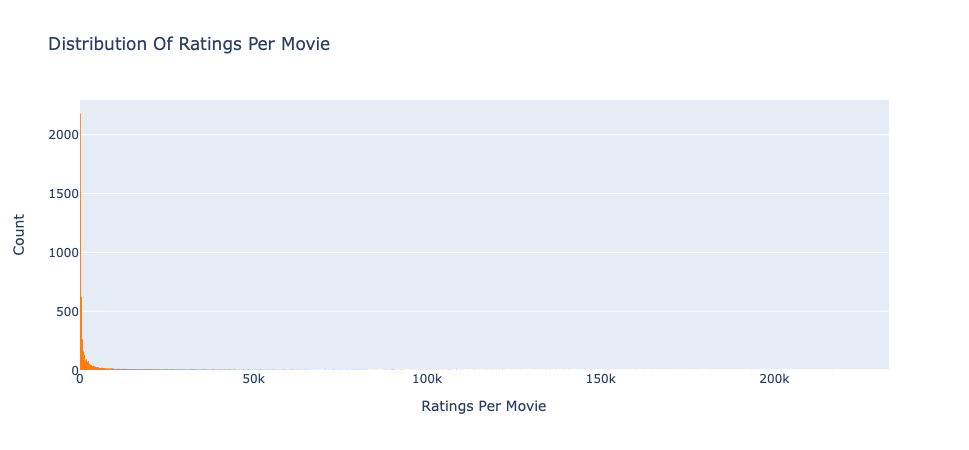

In [8]:
# get data
data = ts.groupby('MovieID')['Rating'].count()

# create trace
trace = go.Histogram(x = data.values,
                     name = 'Ratings',
                     xbins = dict(start = 0,
                                  size = 50),
                     marker = dict(color = '#ff7f0e'))
# create layout
layout = go.Layout(title = 'Distribution Of Ratings Per Movie',
                   xaxis = dict(title = 'Ratings Per Movie'),
                   yaxis = dict(title = 'Count'),
                   bargap = 0.2)

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

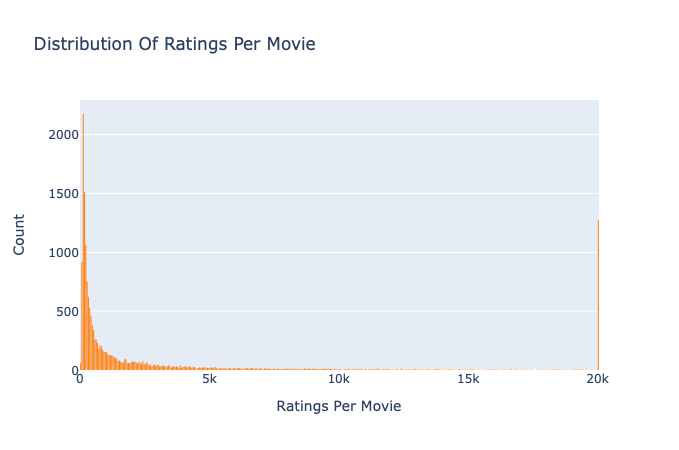

In [12]:
# get data
data = ts.groupby('MovieID')['Rating'].count().clip(upper = 20000)

# create trace
trace = go.Histogram(x = data.values,
                     name = 'Ratings',
                     xbins = dict(start = 0,
                                  size = 50), #10
                     marker = dict(color = '#ff7f0e'))
# create layout
layout = go.Layout(title = 'Distribution Of Ratings Per Movie',
                   xaxis = dict(title = 'Ratings Per Movie'),
                   yaxis = dict(title = 'Count'),
                   bargap = 0.2)

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

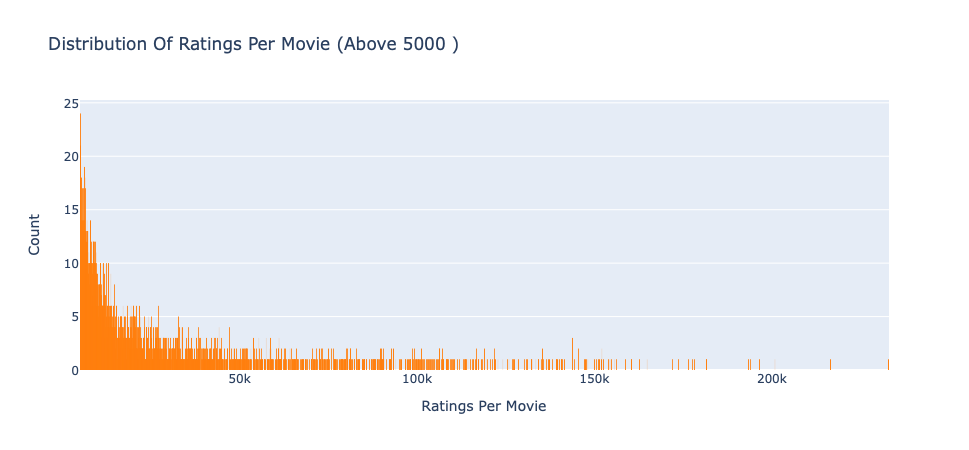

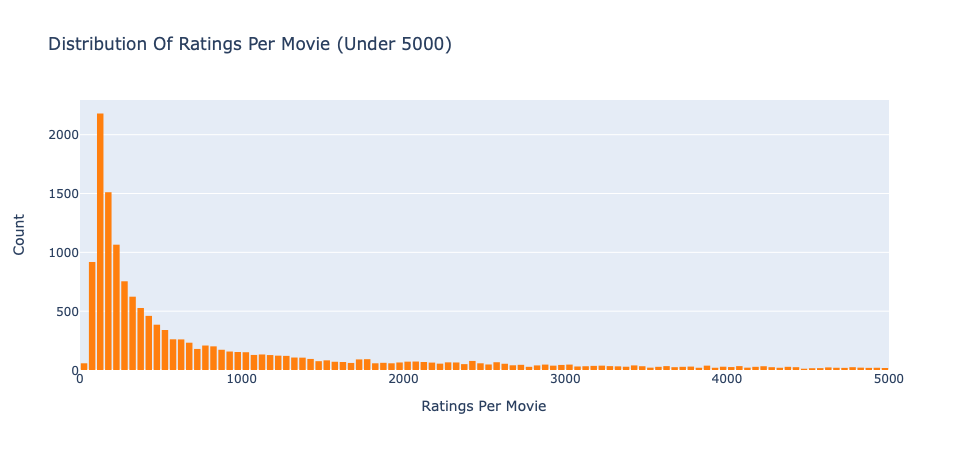

In [15]:
# get data
clip = 5000
data = ts.groupby('MovieID')['Rating'].count()
data.values.sort()
data0 = data[data.values >= clip] # data of few rattings
data1 = data[data.values < clip] # data of many rattings 

# create trace
trace = go.Histogram(x = data0.values,
                     name = 'Ratings',
                     xbins = dict(start = 0,
                                  size = 50), # 10
                     marker = dict(color = '#ff7f0e'))
# create layout
layout = go.Layout(title = f'Distribution Of Ratings Per Movie (Above {clip} )',
                   xaxis = dict(title = 'Ratings Per Movie'),
                   yaxis = dict(title = 'Count'),
                   bargap = 0.2)

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)
del data0

# create trace
trace = go.Histogram(x = data1.values,
                     name = 'Ratings',
                     xbins = dict(start = 0,
                                  size = 50), # 10
                     marker = dict(color = '#ff7f0e'))
# create layout
layout = go.Layout(title = f'Distribution Of Ratings Per Movie (Under {clip})',
                   xaxis = dict(title = 'Ratings Per Movie'),
                   yaxis = dict(title = 'Count'),
                   bargap = 0.2)

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)
del data1

# User rating frequency distribution

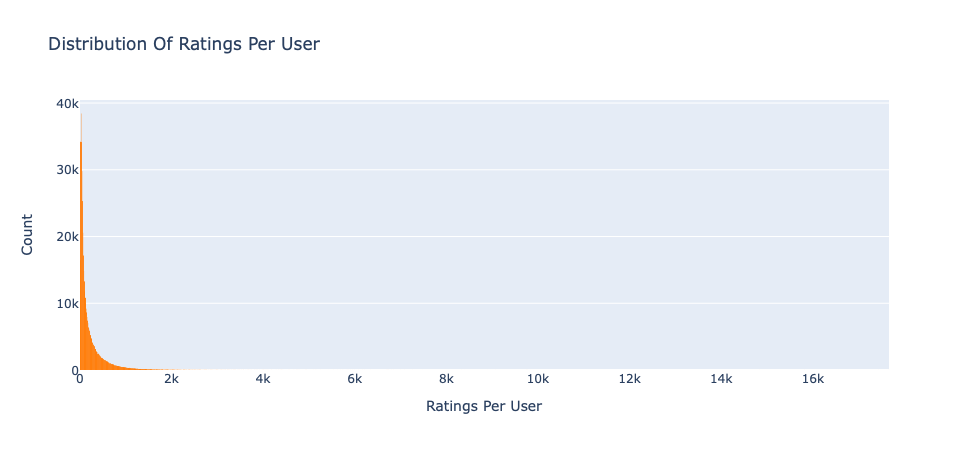

In [17]:
# get data
data = ts.groupby('CustomerID')['Rating'].count()

# create trace
trace = go.Histogram(x = data.values,
                     name = 'Ratings',
                     xbins = dict(start = 0,
                                  size = 10), # 4
                     marker = dict(color = '#ff7f0e'))
# create layout
layout = go.Layout(title = 'Distribution Of Ratings Per User',
                   xaxis = dict(title = 'Ratings Per User'),
                   yaxis = dict(title = 'Count'),
                   bargap = 0.2)

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

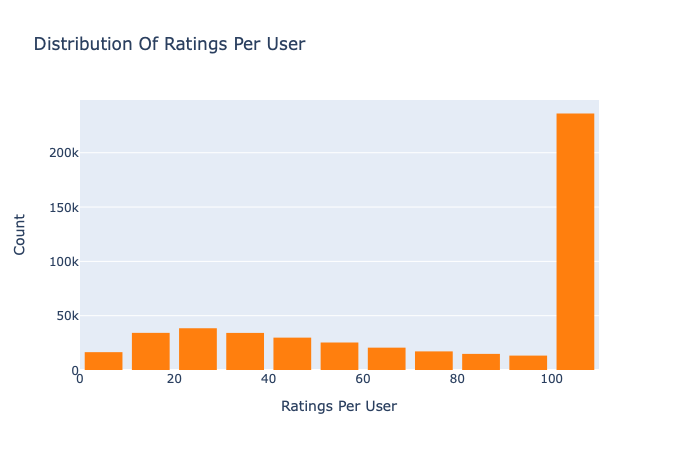

In [19]:
# get data
data = ts.groupby('CustomerID')['Rating'].count().clip(upper = 100)

# create trace
trace = go.Histogram(x = data.values,
                     name = 'Ratings',
                     xbins = dict(start = 0,
                                  size = 10), # 4
                     marker = dict(color = '#ff7f0e'))
# create layout
layout = go.Layout(title = 'Distribution Of Ratings Per User',
                   xaxis = dict(title = 'Ratings Per User'),
                   yaxis = dict(title = 'Count'),
                   bargap = 0.2)

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

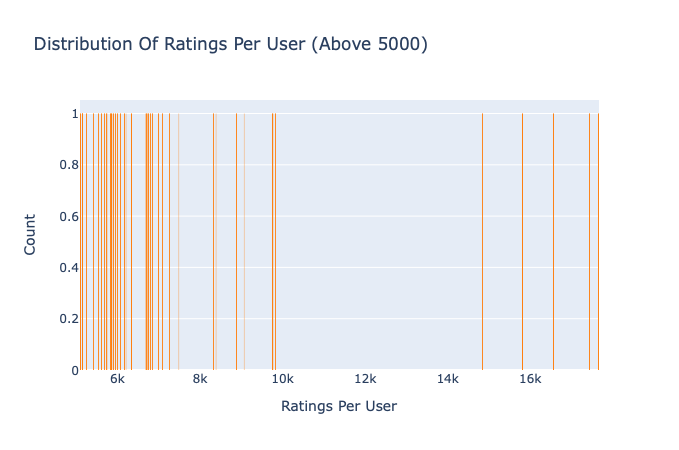

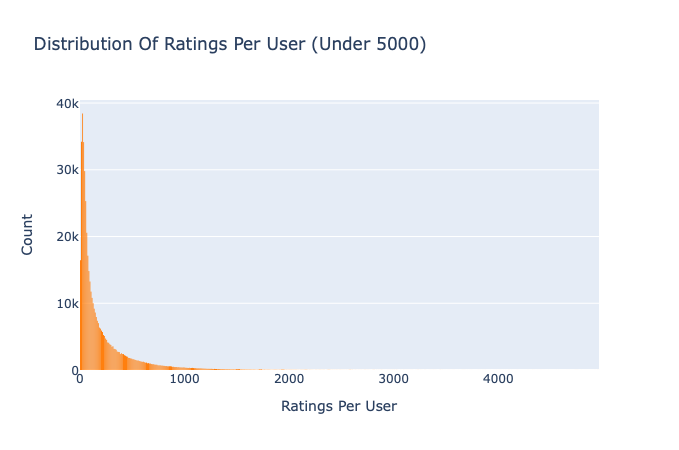

In [24]:
##### ratings per user clipped #####
# get data
clip = 5000
data = ts.groupby('CustomerID')['Rating'].count()
data.values.sort()
data0 = data[data.values > clip] # data of few rattings
data1 = data[data.values <= clip] # data of many rattings 

# create trace
trace = go.Histogram(x = data0.values,
                     name = 'Ratings',
                     xbins = dict(start = 0,
                                  size = 10), # 4
                     marker = dict(color = '#ff7f0e'))
# create layout
layout = go.Layout(title = f'Distribution Of Ratings Per User (Above {clip})',
                   xaxis = dict(title = 'Ratings Per User'),
                   yaxis = dict(title = 'Count'),
                   bargap = 0.2)

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)
del data0 

# create trace
trace = go.Histogram(x = data1.values,
                     name = 'Ratings',
                     xbins = dict(start = 0,
                                  size = 10), # 4
                     marker = dict(color = '#ff7f0e'))
# create layout
layout = go.Layout(title = f'Distribution Of Ratings Per User (Under {clip})',
                   xaxis = dict(title = 'Ratings Per User'),
                   yaxis = dict(title = 'Count'),
                   bargap = 0.2)

# create plot
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)
del data1